In [1]:
%matplotlib inline

%load_ext autoreload
%autoreload 2

In [29]:
import os

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import seaborn as sns
sns.set_context('notebook')
import numpy as np
import pandas as pd
from PIL import Image
from astropy.table import Table  # just to read fits

In [30]:
os.chdir('/home/walml/repos/zoobot')

In [31]:
ml_loc = 'results/temp/decals_n2_allq_m0_all_mean.csv'  # load the predictions (only one model here)
ml_raw = pd.read_csv(ml_loc)
print('Galaxies with ML predictions: ' + str(len(ml)))
ml_raw['bar_any_fraction'] = ml_raw['bar_strong_fraction'] + ml_raw['bar_weak_fraction']

Galaxies with ML predictions: 309398


In [36]:
catalog_loc = 'data/decals/decals_master_catalog.csv'
catalog = pd.read_csv(catalog_loc, dtype={'subject_id': str})  # original catalog
catalog['file_loc'] = catalog['local_png_loc'].apply(lambda x: '/media/walml/beta/decals/png_native' + x[35:])


In [37]:
catalog['file_loc']

0         /media/walml/beta/decals/png_native/dr5/J094/J...
1         /media/walml/beta/decals/png_native/dr5/J094/J...
2         /media/walml/beta/decals/png_native/dr5/J094/J...
3         /media/walml/beta/decals/png_native/dr5/J094/J...
4         /media/walml/beta/decals/png_native/dr5/J094/J...
                                ...                        
309393    /media/walml/beta/decals/png_native/dr5/J143/J...
309394    /media/walml/beta/decals/png_native/dr5/J143/J...
309395    /media/walml/beta/decals/png_native/dr5/J230/J...
309396    /media/walml/beta/decals/png_native/dr5/J235/J...
309397    /media/walml/beta/decals/png_native/dr5/J235/J...
Name: file_loc, Length: 309398, dtype: object

In [38]:
ml = pd.merge(ml_raw, catalog[['iauname', 'file_loc']], how='inner', on='iauname')

In [41]:
# copied from touch table
def quality_check(df, bin_col, n_bins=10, n_galaxies_per_bin=10):
    df['binned'], bins = pd.cut(df[bin_col], n_bins, labels=False, retbins=True)
    scale = 3
    plt.figure(figsize=(scale * n_galaxies_per_bin, scale * n_bins))
    gs1 = gridspec.GridSpec(n_galaxies_per_bin, n_bins)
    gs1.update(wspace=0.0, hspace=0.0)
    for bin_n in range(n_bins):
        selected_df = df.query('binned == {}'.format(bin_n))
        selected_df = selected_df.sample(len(selected_df))  # shuffle
        for galaxy_n in range(n_galaxies_per_bin):
            if galaxy_n < len(selected_df):
                galaxy = selected_df.iloc[galaxy_n]
                image = Image.open(galaxy['file_loc'])
                ax = plt.subplot(gs1[galaxy_n, bin_n])
                ax.imshow(image)
#                 ax.text(50, 50, 'Spiral = {:.2f}'.format(galaxy['has-spiral-arms_fraction']), fontsize=16, color='r')
#                 ax.text(50, 120, 'N = {}'.format(galaxy['total']), fontsize=16, color='r')
                if galaxy_n == 0:
                    ax.text(80, -50, 'Feat: {:.2f} to {:.2f}'.format(bins[bin_n], bins[bin_n + 1]), fontsize=16, color='black')
                ax.axis('off')
#     plt.savefig('touch_table_retirement_{}.pdf'.format(retirement_limit))
    return df

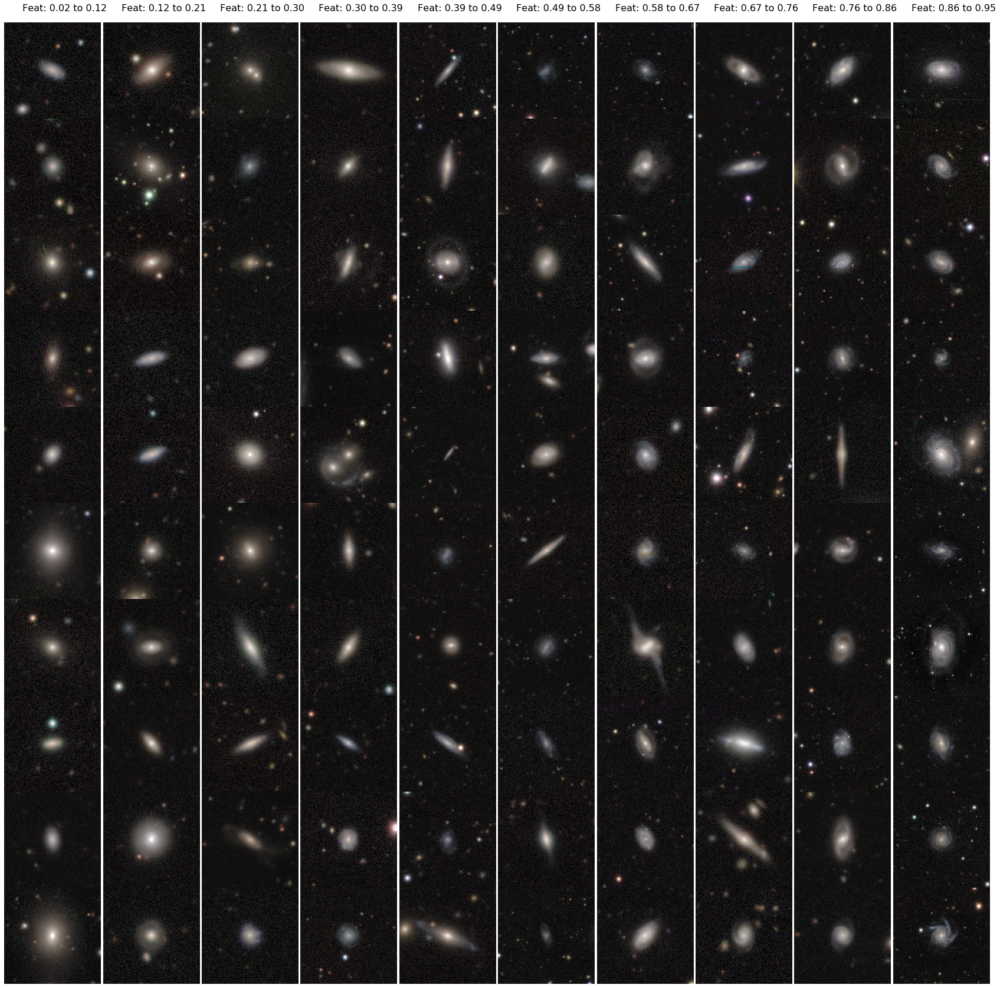

In [43]:
_ = quality_check(ml, 'smooth-or-featured_featured-or-disk_fraction')

In [ ]:
# around 02-.25 for smooth (·2 to be sure), .35-.4 for featured galaxies (.5 to be sure)

/home/walml/anaconda3/envs/zoobot/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


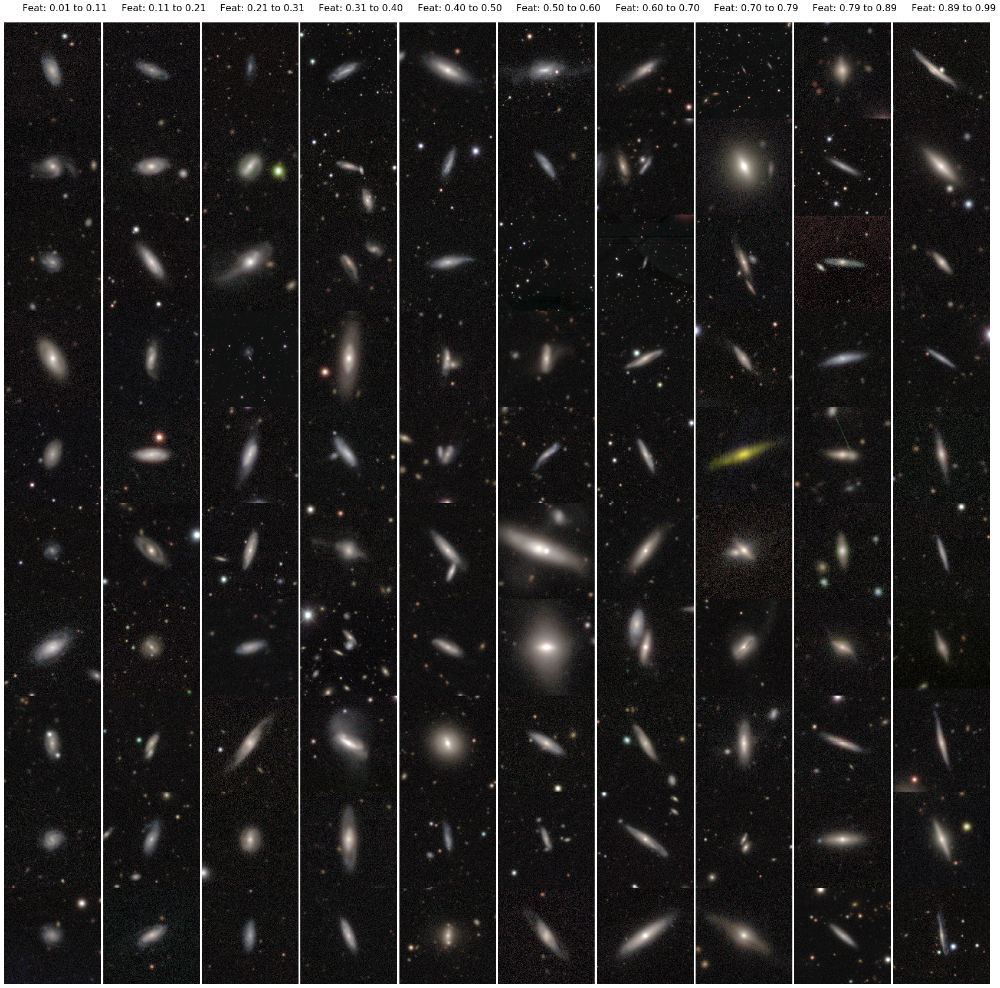

In [46]:
featured = ml['smooth-or-featured_featured-or-disk_fraction'] > 0.4
_ = quality_check(ml[featured], 'disk-edge-on_yes_fraction')

In [ ]:
# around 0.4-0.5 for edge-on disks

/home/walml/anaconda3/envs/zoobot/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


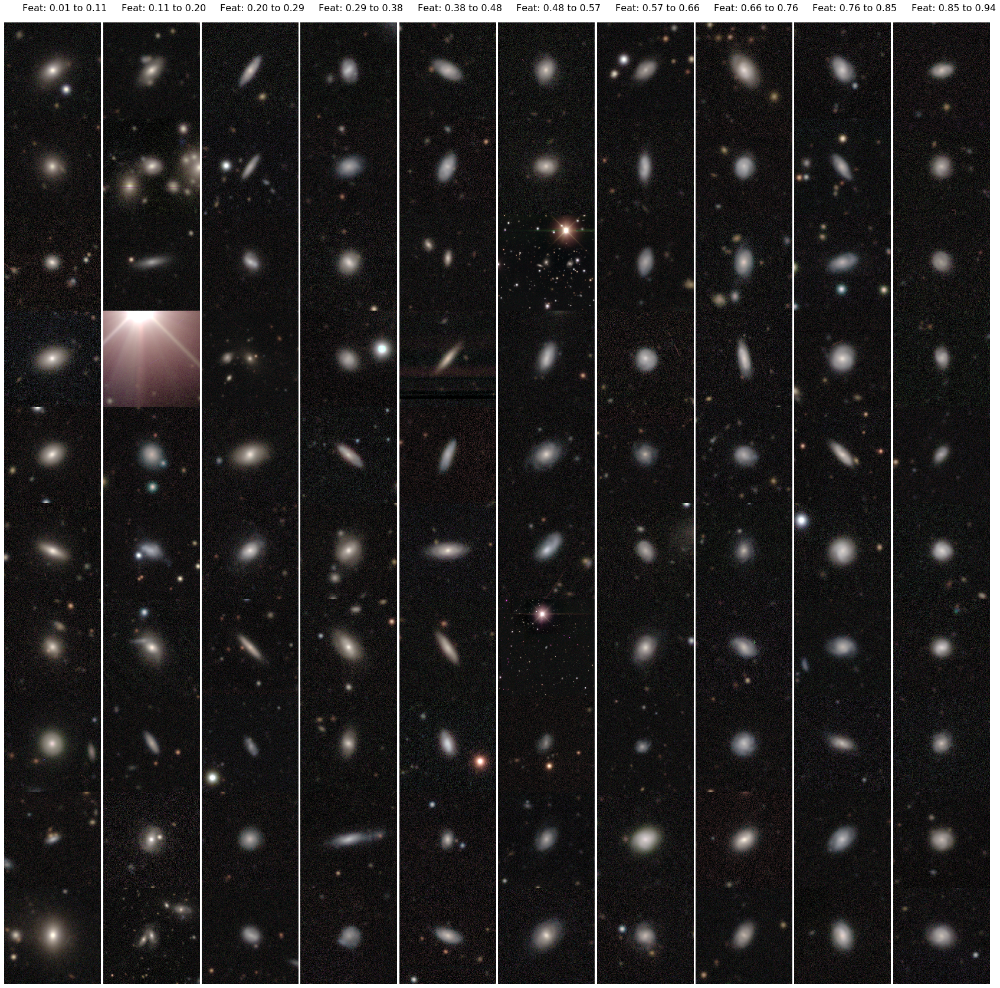

In [47]:
face_on = featured & ml['disk-edge-on_yes_fraction'] < 0.45
_ = quality_check(ml[face_on], 'has-spiral-arms_yes_fraction')

In [ ]:
# spiral arms - somewhere around 0.5

In [49]:
# redshift effect
_ = quality_check(ml, 'redshift')

KeyError: 'z'